## <font color='purple'> Data 255 - Lab 1 - Part 3 - Pre-Trained Model

<font color='purple'> 11. Use pre-trained models such as YOLOv8 for object detection and print the IOU. \
<font color='purple'> 12. Experiment with pre-trained models and show the IOU of the test data set. Show
tables and graphs of how the results change.

<font color='blue'> We have chosen our model as YoloV8. 
    
<font color='blue'> YOLOv8 uses an enhanced backbone architecture and is based on CSPNet (Cross Stage Partial Network). This helps in reducing redundant computations and improving feature extraction efficiency. This enhances performance without sacrificing speed. The model introduces new architectural changes, like a better neck and head design (e.g., PANet and FPN enhancements), which improve multi-scale feature fusio

In [1]:
!pip install -q --disable-pip-version-check ultralytics

In [2]:
import os
import random
import yaml
import numpy as np
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import Image, display
from PIL import Image
from pathlib import Path
from sklearn.metrics import confusion_matrix

<font color='blue'> We used Kaggle's notebook feature to test our models as Kaggle provides free GPU Quota. The dataset from Google drive was uploaded to Kaggle. 
    
<font color='blue'> The original dataset was formatted as follows:
    
    -labels_test
    -labels_train
    -train
      -  images
      -  labels (in Yolo format)
    -  test
      -  images
      -  labels (in Yolo format)
    - data.yaml
    
<font color='blue'> For testing with Yolo, we will not be using the directories "labels_test" and "labels_train". We performed a split on the train dataset prior to creating the dataset in Kaggle. We used "FileMove.ipynb" which is part of our deliverables. The new Structure was as follows.
    
    -train
        - images
        - labels
    -val
        - images
        - labels
    -test
        - images
        - labels
    -data.yaml
    

<font color='blue'> Removing left over files in Kaggle working directory.

In [3]:
!rm -rf /kaggle/working/*

<font color='blue'> Disabling WANDB mode as Yolo tries to read weights from Weights and Biases repository. However, we don't want that

In [4]:
os.environ['WANDB_MODE'] = 'disabled'

In [5]:
os.environ['CUDA_LAUNCH_BLOCKING'] = '1'

## <font color='blue'><b> First Pass: </b>Baseline Yolo V8 nano model with default params and 10 Epochs

<font color='blue'> Running in Training Mode with baseline model with 10 epochs. All default parameters

In [6]:
!yolo task=detect mode=train \
    model=yolov8n.pt \
    data=/kaggle/input/roadsign-yolo/data.yaml \
    epochs=10 \
    verbose=False

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
100%|███████████████████████████████████████| 6.25M/6.25M [00:00<00:00, 175MB/s]
Ultralytics 8.3.23 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/kaggle/input/roadsign-yolo/data.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=False, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4,

<font color='blue'> Running in Validate Mode

In [7]:
!yolo task=detect mode=val \
    model=/kaggle/working/runs/detect/train/weights/best.pt \
    data=/kaggle/input/roadsign-yolo/data.yaml

Ultralytics 8.3.23 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 168 layers, 3,010,523 parameters, 0 gradients, 8.1 GFLOPs
val: Scanning /kaggle/input/roadsign-yolo/Archive/val/labels... 624 images, 0 ba
val: WARNING ⚠️ Cache directory /kaggle/input/roadsign-yolo/Archive/val is not writeable, cache not saved.
                 Class     Images  Instances      Box(P          R      mAP50  m
                   all        624        988      0.882      0.808      0.883      0.721
    Beware of children          4          4      0.328       0.25      0.281      0.208
             Crosswalk         76         91          1       0.97      0.984       0.72
Dangerous Left Curve Ahead          9          9      0.507          1      0.834      0.712
Dangerous Rright Curve Ahead         57         57      0.977      0.756      0.948      0.812
              No Entry          2          2      0.858          1      0.995      0.895
        No_Over_Ta

<font color='blue'> Running in Predict Mode

In [8]:
!yolo task=detect mode=predict \
model=/kaggle/working/runs/detect/train/weights/best.pt \
conf=0.25 \
source=/kaggle/input/roadsign-yolo/Archive/test/images \
save=True \
save_txt=True \
save_conf=True \
verbose=False

Ultralytics 8.3.23 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 168 layers, 3,010,523 parameters, 0 gradients, 8.1 GFLOPs
Results saved to runs/detect/predict
608 labels saved to runs/detect/predict/labels
💡 Learn more at https://docs.ultralytics.com/modes/predict


<font color='blue'> Function to Plot Yolo Results

In [11]:
def plot_results(image_paths):
    num_images = len(image_paths)
    cols = 2
    rows = (num_images + 1) // cols
    fig, axes = plt.subplots(rows, cols, figsize=(12, 12))

    axes = axes.flatten()

    for ax, image_path in zip(axes, image_paths):
        img = Image.open(image_path)
        ax.imshow(img)
        ax.axis('off')
        ax.set_title(os.path.basename(image_path), fontsize=10)

    for i in range(num_images, len(axes)):
        axes[i].axis('off')

    plt.tight_layout()
    plt.show()

<font color='blue'> Plotting results from Train Mode

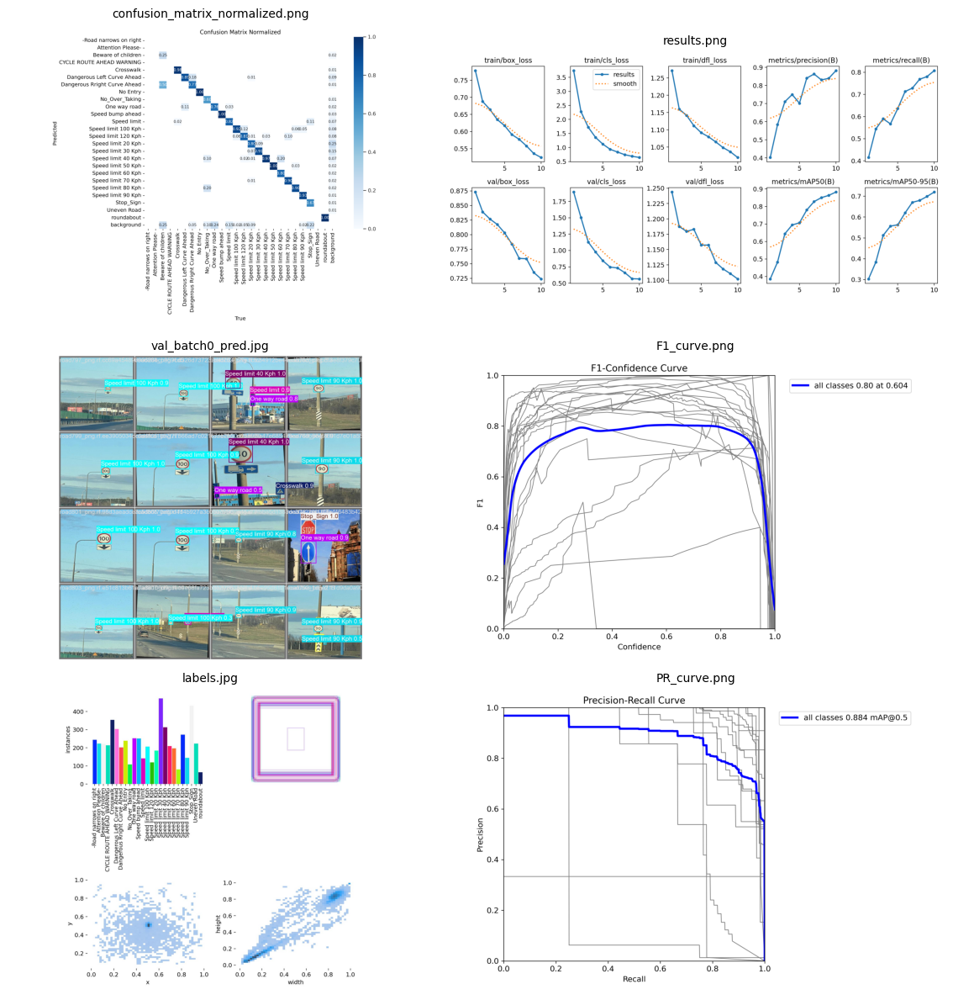

In [12]:
image_paths = [
    '/kaggle/working/runs/detect/train/confusion_matrix_normalized.png',
    '/kaggle/working/runs/detect/train/results.png',
    '/kaggle/working/runs/detect/train/val_batch0_pred.jpg',
    '/kaggle/working/runs/detect/train/F1_curve.png',
    '/kaggle/working/runs/detect/train/labels.jpg',
    '/kaggle/working/runs/detect/train/PR_curve.png'
]

plot_results(image_paths)

<font color='blue'> Plotting results from Validate Mode

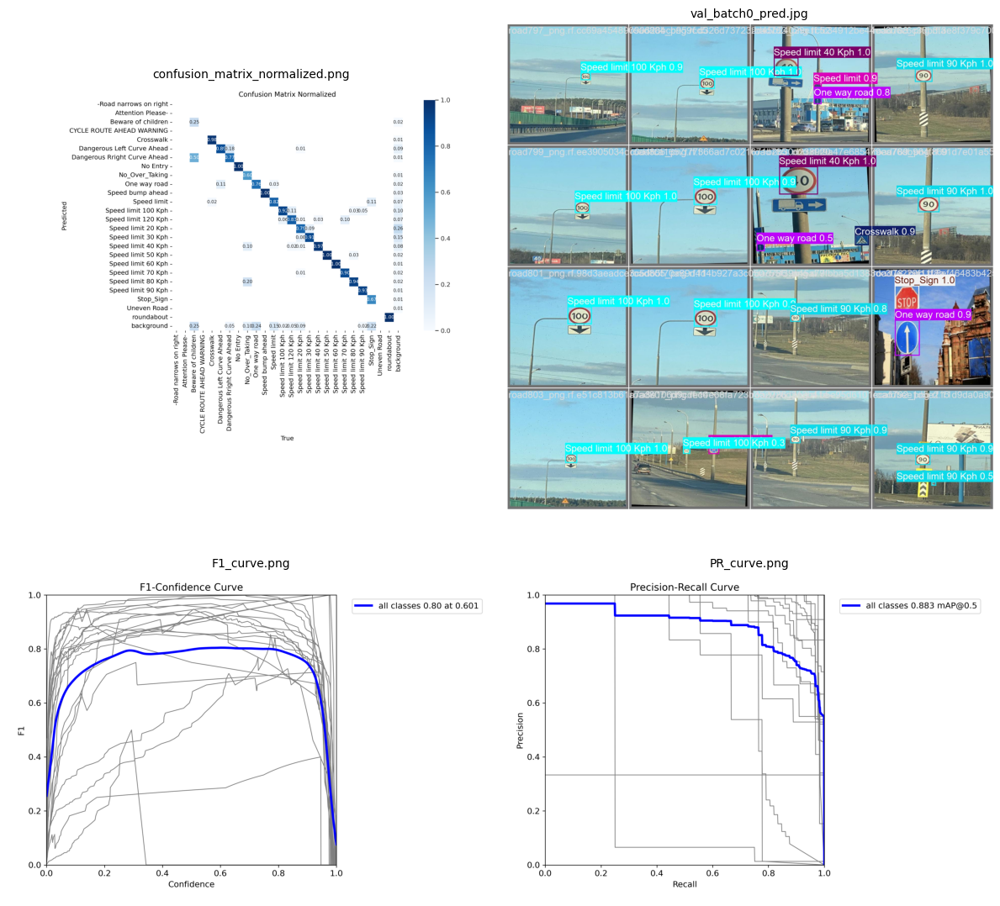

In [13]:
image_paths = [
    '/kaggle/working/runs/detect/val/confusion_matrix_normalized.png',
    '/kaggle/working/runs/detect/val/val_batch0_pred.jpg',
    '/kaggle/working/runs/detect/val/F1_curve.png',
    '/kaggle/working/runs/detect/val/PR_curve.png'
]

plot_results(image_paths)

<font color='blue'> Function to Plot Predicted Images

In [14]:
def plot_predictions(predict_folder):
    image_files = [f for f in os.listdir(predict_folder) if f.endswith(('.png', '.jpg', '.jpeg', '.webp'))]

    random_images = random.sample(image_files, min(20, len(image_files)))
    num_cols = 5
    num_rows = (len(random_images) + num_cols - 1) // num_cols

    fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(20, 4 * num_rows))

    for i, img_file in enumerate(random_images):
        img_path = os.path.join(predict_folder, img_file)
        img = Image.open(img_path)

        ax = axes[i // num_cols, i % num_cols]
        ax.imshow(img)
        ax.axis('off')

    for j in range(len(random_images), num_rows * num_cols):
        axes[j // num_cols, j % num_cols].axis('off')

    # Adjust layout
    plt.suptitle('Evaluating Predictions (Random 20)', fontsize=16)
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()

<font color='blue'> Plotting results from Train Mode

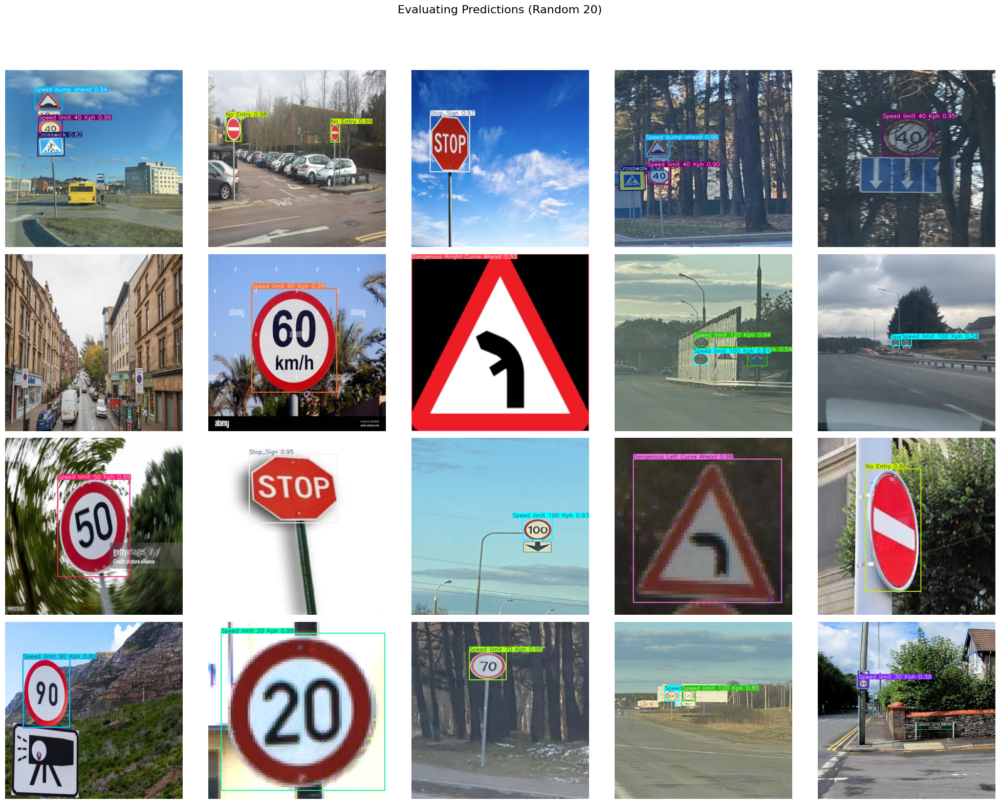

In [15]:
predict_folder = '/kaggle/working/runs/detect/predict'

plot_predictions(predict_folder)

<font color='blue'> Function to Parse the Yolo label files

In [16]:
def read_yolo_label(label_path, include_confidence=False):
    boxes = []
    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            for line in f.readlines():
                values = line.strip().split()
                
                if include_confidence:
                    if len(values) >= 6:
                        class_id, x_center, y_center, width, height, confidence = map(float, values[:6])
                        boxes.append([class_id, x_center, y_center, width, height, confidence])
                else:
                    if len(values) >= 5:
                        class_id, x_center, y_center, width, height = map(float, values[:5])
                        boxes.append([class_id, x_center, y_center, width, height])
    
    return np.array(boxes)

<font color='blue'> Function to Calculate Metrics for Predictions

In [17]:
def calculate_metrics(gt_dir, pred_dir, img_width, img_height, iou_threshold=0.5, conf_threshold=0.25):
    gt_files = sorted(Path(gt_dir).glob('*.txt'))
    metrics = {
        'total_gt_boxes': 0,
        'total_pred_boxes': 0,
        'true_positives': 0,
        'false_positives': 0,
        'false_negatives': 0,
        'class_accuracy': 0,
        'average_iou': 0,
        'average_confidence': 0,
        'ious': [],
        'confidences': []
    }
    
    for gt_file in gt_files:
        pred_file = Path(pred_dir) / gt_file.name
        
        if not pred_file.exists():
            continue
        
        gt_boxes = read_yolo_label(gt_file, include_confidence=False)
        pred_boxes = read_yolo_label(pred_file, include_confidence=True)
        
        if len(pred_boxes) > 0:
            confident_mask = pred_boxes[:, 5] >= conf_threshold
            pred_boxes = pred_boxes[confident_mask]
        
        metrics['total_gt_boxes'] += len(gt_boxes)
        metrics['total_pred_boxes'] += len(pred_boxes)
        
        gt_boxes_xyxy = np.array([yolo_to_xyxy(box, img_width, img_height) for box in gt_boxes]) if len(gt_boxes) > 0 else []
        pred_boxes_xyxy = np.array([yolo_to_xyxy(box, img_width, img_height) for box in pred_boxes]) if len(pred_boxes) > 0 else []
        
        matched_gt = set()
        
        for pred_idx, pred_box in enumerate(pred_boxes):
            best_iou = 0
            best_gt_idx = -1
            
            for gt_idx, gt_box in enumerate(gt_boxes):
                if gt_idx in matched_gt:
                    continue
                    
                iou = calculate_iou(pred_boxes_xyxy[pred_idx], gt_boxes_xyxy[gt_idx])
                
                if iou > best_iou:
                    best_iou = iou
                    best_gt_idx = gt_idx
            
            metrics['confidences'].append(pred_box[5])
            
            if best_iou >= iou_threshold:
                metrics['true_positives'] += 1
                matched_gt.add(best_gt_idx)
                metrics['ious'].append(best_iou)
                
                if pred_box[0] == gt_boxes[best_gt_idx][0]:
                    metrics['class_accuracy'] += 1
            else:
                metrics['false_positives'] += 1
        
        metrics['false_negatives'] += len(gt_boxes) - len(matched_gt)
    
    metrics['average_iou'] = np.mean(metrics['ious']) if metrics['ious'] else 0
    metrics['average_confidence'] = np.mean(metrics['confidences']) if metrics['confidences'] else 0
    metrics['class_accuracy'] = metrics['class_accuracy'] / metrics['true_positives'] if metrics['true_positives'] > 0 else 0
    
    metrics['precision'] = metrics['true_positives'] / (metrics['true_positives'] + metrics['false_positives']) if (metrics['true_positives'] + metrics['false_positives']) > 0 else 0
    metrics['recall'] = metrics['true_positives'] / (metrics['true_positives'] + metrics['false_negatives']) if (metrics['true_positives'] + metrics['false_negatives']) > 0 else 0
    metrics['f1_score'] = 2 * (metrics['precision'] * metrics['recall']) / (metrics['precision'] + metrics['recall']) if (metrics['precision'] + metrics['recall']) > 0 else 0
    
    return metrics

<font color='blue'> Function Convert Yolo format to XY Co-ordinates

In [18]:
def yolo_to_xyxy(box, img_width, img_height):
    x_center, y_center, width, height = box[1], box[2], box[3], box[4]
    
    x_min = (x_center - width/2) * img_width
    y_min = (y_center - height/2) * img_height
    x_max = (x_center + width/2) * img_width
    y_max = (y_center + height/2) * img_height
    
    return np.array([x_min, y_min, x_max, y_max])

<font color='blue'> Function to calculate IOU

In [19]:
def calculate_iou(box1, box2):
    """
    Calculate IoU between two boxes in (x_min, y_min, x_max, y_max) format
    """
    x1 = max(box1[0], box2[0])
    y1 = max(box1[1], box2[1])
    x2 = min(box1[2], box2[2])
    y2 = min(box1[3], box2[3])
    
    intersection = max(0, x2 - x1) * max(0, y2 - y1)
    
    box1_area = (box1[2] - box1[0]) * (box1[3] - box1[1])
    box2_area = (box2[2] - box2[0]) * (box2[3] - box2[1])
    
    union = box1_area + box2_area - intersection
    
    return intersection / union if union > 0 else 0

<font color='blue'> Wrapper for calling Calculate Metrics

In [20]:
def calc_metrics(gt_dir, pred_dir):
    img_width = 832
    img_height = 832

    # Calculate metrics
    metrics = calculate_metrics(
        gt_dir=gt_dir, 
        pred_dir=pred_dir,
        img_width=img_width,
        img_height=img_height,
        iou_threshold=0.5,
        conf_threshold=0.25
    )

    print("\nDetection Metrics:")
    print(f"Total GT boxes: {metrics['total_gt_boxes']}")
    print(f"Total Predicted boxes: {metrics['total_pred_boxes']}")
    print(f"True Positives: {metrics['true_positives']}")
    print(f"False Positives: {metrics['false_positives']}")
    print(f"False Negatives: {metrics['false_negatives']}")
    print(f"Average IoU: {metrics['average_iou']:.4f}")
    print(f"Average Confidence: {metrics['average_confidence']:.4f}")
    print(f"Class Accuracy: {metrics['class_accuracy']:.4f}")
    print(f"Precision: {metrics['precision']:.4f}")
    print(f"Recall: {metrics['recall']:.4f}")
    print(f"F1 Score: {metrics['f1_score']:.4f}")

<font color='blue'> Calculate Prediction Metrics from First Model Run

In [21]:
gt_dir = "/kaggle/input/roadsign-yolo/Archive/test/labels"
pred_dir = "/kaggle/working/runs/detect/predict/labels"
calc_metrics(gt_dir, pred_dir)


Detection Metrics:
Total GT boxes: 783
Total Predicted boxes: 853
True Positives: 765
False Positives: 88
False Negatives: 18
Average IoU: 0.8993
Average Confidence: 0.8573
Class Accuracy: 0.9346
Precision: 0.8968
Recall: 0.9770
F1 Score: 0.9352


## <font color='blue'> Pass 2: Changing Optimizer, Increasing Epochs, Changing Learning Rate

<font color='blue'> Running in Training Mode with baseline model with 20 epochs. Changing image size to 832 and increasing batch size to 64. Overriding the default optimizer with AdamW and learning rate of 0.005. Also, adding a scheduler parameter to step the learning rate by a factor of 0.0001

In [23]:
!yolo task=detect mode=train \
    model=yolov8n.pt \
    data=/kaggle/input/roadsign-yolo/data.yaml \
    optimizer='AdamW' \
    verbose=False \
    epochs=20 \
    imgsz=832 \
    batch=64 \
    lr0=0.005 \
    lrf=0.0001

Ultralytics 8.3.23 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/kaggle/input/roadsign-yolo/data.yaml, epochs=20, time=None, patience=100, batch=64, imgsz=832, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=False, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_c

<font color='blue'> Running in Validate Mode

In [24]:
!yolo task=detect mode=val \
    model=/kaggle/working/runs/detect/train2/weights/best.pt \
    data=/kaggle/input/roadsign-yolo/data.yaml

Ultralytics 8.3.23 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 168 layers, 3,010,523 parameters, 0 gradients, 8.1 GFLOPs
val: Scanning /kaggle/input/roadsign-yolo/Archive/val/labels... 624 images, 0 ba
val: WARNING ⚠️ Cache directory /kaggle/input/roadsign-yolo/Archive/val is not writeable, cache not saved.
                 Class     Images  Instances      Box(P          R      mAP50  m
                   all        624        988      0.885      0.815      0.895      0.727
    Beware of children          4          4      0.648       0.25      0.592      0.463
             Crosswalk         76         91          1      0.894      0.978      0.738
Dangerous Left Curve Ahead          9          9      0.559          1      0.606      0.451
Dangerous Rright Curve Ahead         57         57      0.994      0.754      0.949      0.799
              No Entry          2          2      0.868          1      0.995      0.895
        No_Over_Ta

<font color='blue'> Plotting results from Train Run

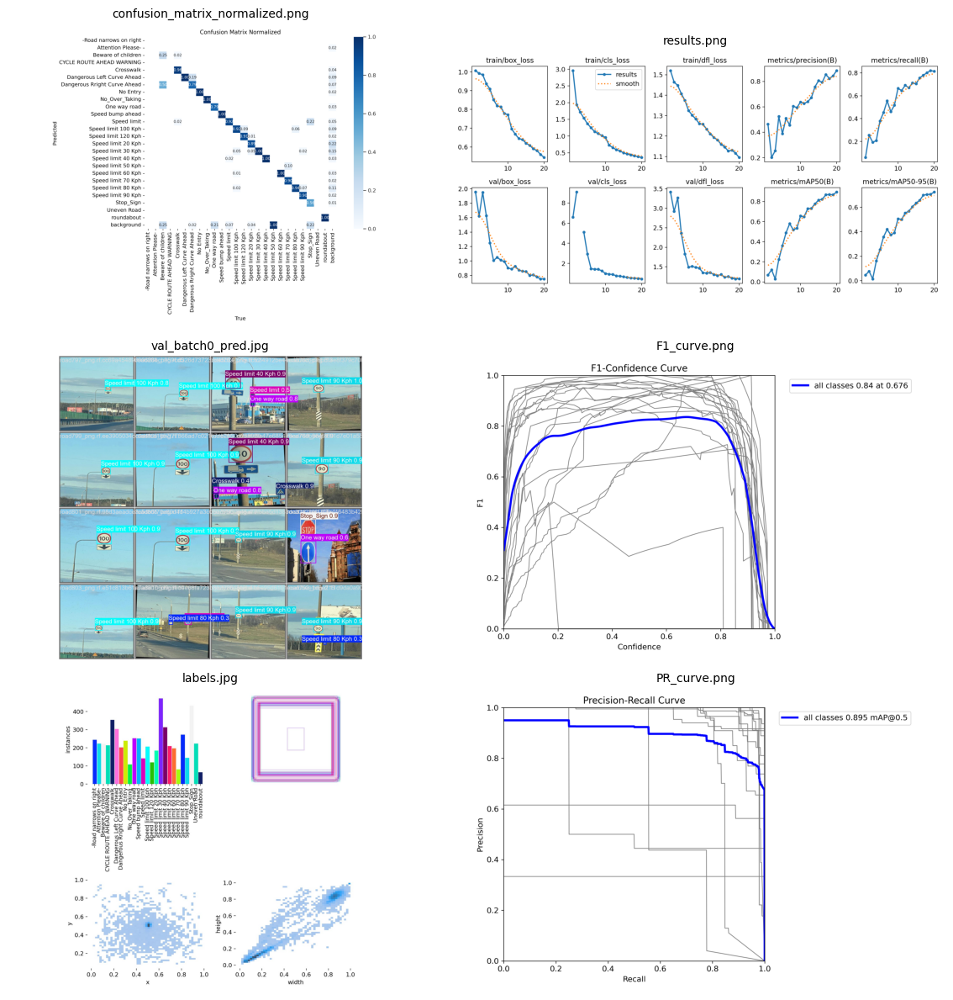

In [25]:
image_paths = [
    '/kaggle/working/runs/detect/train2/confusion_matrix_normalized.png',
    '/kaggle/working/runs/detect/train2/results.png',
    '/kaggle/working/runs/detect/train2/val_batch0_pred.jpg',
    '/kaggle/working/runs/detect/train2/F1_curve.png',
    '/kaggle/working/runs/detect/train2/labels.jpg',
    '/kaggle/working/runs/detect/train2/PR_curve.png'
]

plot_results(image_paths)

<font color='blue'> Plotting results from Validate Mode

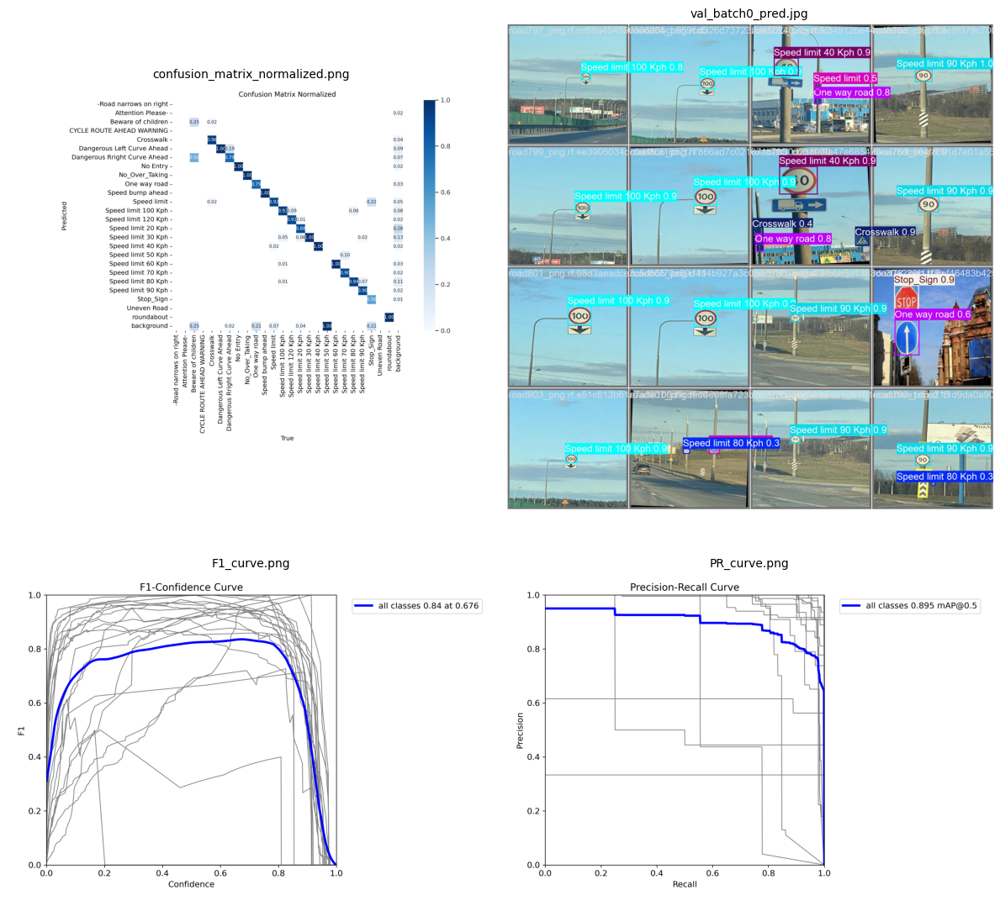

In [26]:
image_paths = [
    '/kaggle/working/runs/detect/val2/confusion_matrix_normalized.png',
    '/kaggle/working/runs/detect/val2/val_batch0_pred.jpg',
    '/kaggle/working/runs/detect/val2/F1_curve.png',
    '/kaggle/working/runs/detect/val2/PR_curve.png'
]

plot_results(image_paths)

<font color='blue'> Running in Predict Mode

In [27]:
!yolo task=detect mode=predict \
model=/kaggle/working/runs/detect/train2/weights/best.pt \
conf=0.25 \
source=/kaggle/input/roadsign-yolo/Archive/test/images \
save=True \
save_txt=True \
save_conf=True \
verbose=False

Ultralytics 8.3.23 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 168 layers, 3,010,523 parameters, 0 gradients, 8.1 GFLOPs
Results saved to runs/detect/predict2
618 labels saved to runs/detect/predict2/labels
💡 Learn more at https://docs.ultralytics.com/modes/predict


<font color='blue'> Plotting random results from Predict Mode

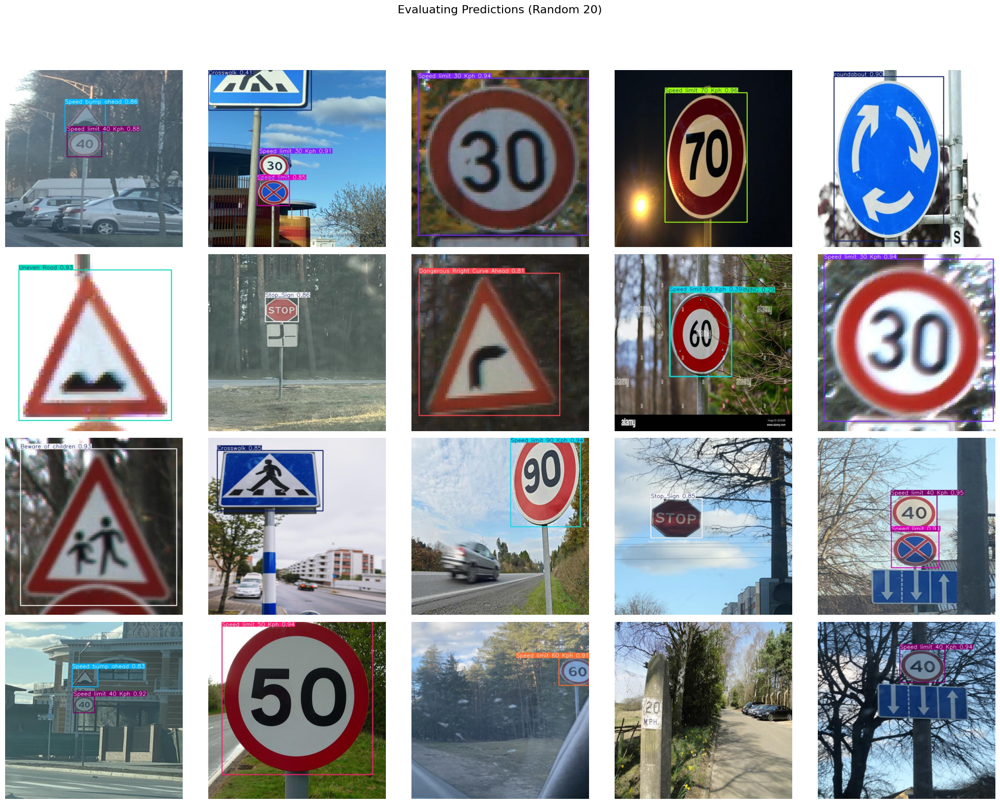

In [28]:
predict_folder = '/kaggle/working/runs/detect/predict2'

plot_predictions(predict_folder)

<font color='blue'> Calculaing metrics on Predicted Results

In [29]:
gt_dir = "/kaggle/input/roadsign-yolo/Archive/test/labels"
pred_dir = "/kaggle/working/runs/detect/predict2/labels"
calc_metrics(gt_dir, pred_dir)


Detection Metrics:
Total GT boxes: 793
Total Predicted boxes: 879
True Positives: 780
False Positives: 99
False Negatives: 13
Average IoU: 0.8976
Average Confidence: 0.8152
Class Accuracy: 0.9321
Precision: 0.8874
Recall: 0.9836
F1 Score: 0.9330


## <font color='blue'> Pass 3: Changing Optimizer, Increasing Epochs, Setting Image Size, Adding Scheduler, Adding Data Augmentations, Weight Decay

<font color='blue'> Running in Train Mode with a multitude of Hyper parameters with a 50 epoch limit. Image sie and batch size will be consistent. Reducing learning rate and scheduler factor to allow better convergence and a lower learning rate. Also, applying multiple data augementations to allow the model to learn from a variety of images in the dataset. Also, added weight decay and warm up epochs, to prevent high early losses. Patience factor increased to 20 to prevent model from terminating too soon in case model is overfitting. Idea is to monitor the performance over high number of epochs to validate. 
    
    Augmentations: 
        Mosaic - 0.4
        Mixup - 0.2
        Rotation - 10 degrees
        hsv_h, hsv_v, hsv_s - Hue, Saturation, Brightness adjustments
        Scale - Image Scaling
        Shear - Shear the image by specific degrees
        perspective - Allow perspective transformation

In [30]:
!yolo task=detect mode=train \
    model=yolov8n.pt \
    data=/kaggle/input/roadsign-yolo/data.yaml \
    optimizer='AdamW' \
    epochs=50 \
    imgsz=832 \
    batch=64 \
    lr0=0.0005 \
    lrf=0.00001 \
    cos_lr=True \
    mosaic=0.4 \
    mixup=0.2 \
    weight_decay = 0.001 \
    warmup_epochs = 3 \
    label_smoothing = 0.05 \
    dropout = 0.1 \
    patience = 20 \
    workers = 8 \
    hsv_h = 0.015  \
    hsv_s = 0.3    \
    hsv_v = 0.3    \
    degrees = 10.0  \
    translate = 0.2 \
    scale = 0.3    \
    shear = 0.2 \
    plots = True \
    perspective=0.0005 \
    iou=0.6 \
    conf=0.5 \
    verbose=False

Ultralytics 8.3.23 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/kaggle/input/roadsign-yolo/data.yaml, epochs=50, time=None, patience=20, batch=64, imgsz=832, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=False, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.1, val=True, split=val, save_json=False, save_hybrid=False, conf=0.5, iou=0.6, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf

<font color='blue'> Running in Validate Mode

In [31]:
!yolo task=detect mode=val \
    model=/kaggle/working/runs/detect/train3/weights/best.pt \
    data=/kaggle/input/roadsign-yolo/data.yaml \
    verbose=False

Ultralytics 8.3.23 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 168 layers, 3,010,523 parameters, 0 gradients, 8.1 GFLOPs
val: Scanning /kaggle/input/roadsign-yolo/Archive/val/labels... 624 images, 0 ba
val: WARNING ⚠️ Cache directory /kaggle/input/roadsign-yolo/Archive/val is not writeable, cache not saved.
                 Class     Images  Instances      Box(P          R      mAP50  m
                   all        624        988      0.948       0.93      0.969      0.776
Speed: 0.9ms preprocess, 4.8ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/val3
💡 Learn more at https://docs.ultralytics.com/modes/val


<font color='blue'> Plotting results from Train Mode

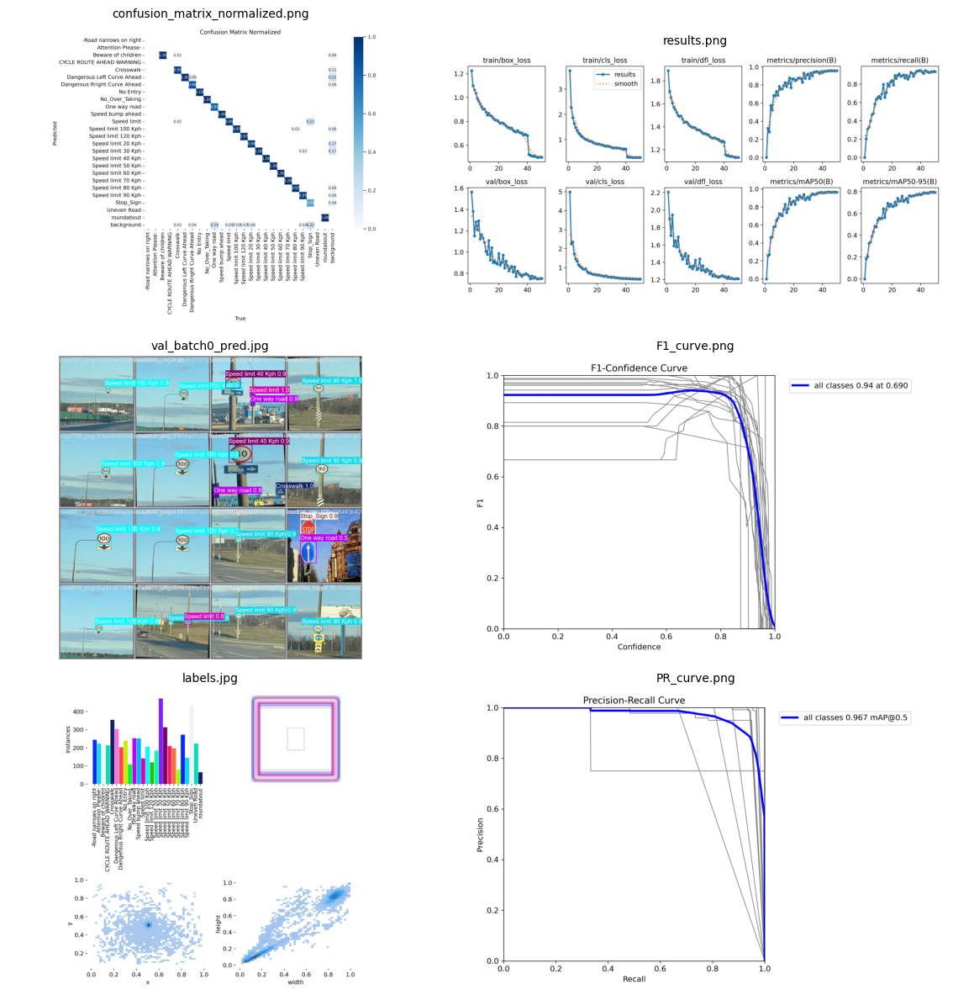

In [32]:
image_paths = [
    '/kaggle/working/runs/detect/train3/confusion_matrix_normalized.png',
    '/kaggle/working/runs/detect/train3/results.png',
    '/kaggle/working/runs/detect/train3/val_batch0_pred.jpg',
    '/kaggle/working/runs/detect/train3/F1_curve.png',
    '/kaggle/working/runs/detect/train3/labels.jpg',
    '/kaggle/working/runs/detect/train3/PR_curve.png'
]

plot_results(image_paths)

<font color='blue'> Plotting results from Validate mode

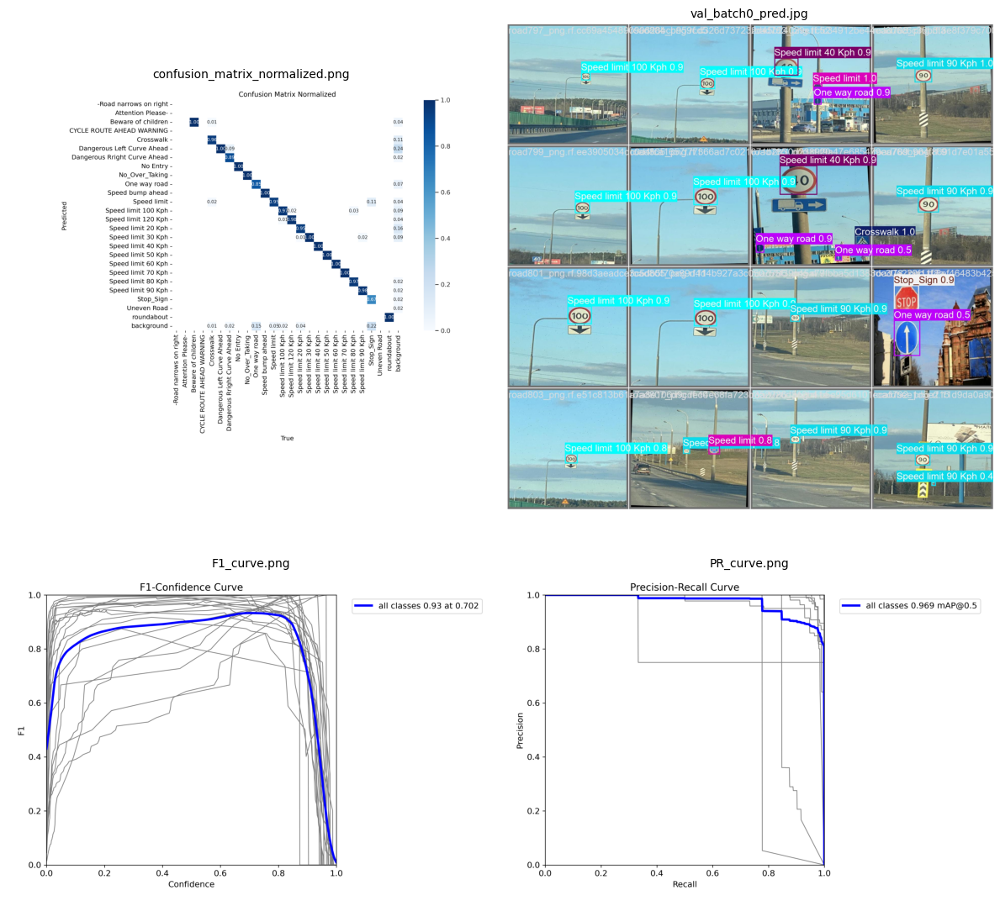

In [33]:
image_paths = [
    '/kaggle/working/runs/detect/val3/confusion_matrix_normalized.png',
    '/kaggle/working/runs/detect/val3/val_batch0_pred.jpg',
    '/kaggle/working/runs/detect/val3/F1_curve.png',
    '/kaggle/working/runs/detect/val3/PR_curve.png'
]

plot_results(image_paths)

<font color='blue'> Running in Predict Mode

In [34]:
!yolo task=detect mode=predict \
model=/kaggle/working/runs/detect/train3/weights/best.pt \
conf=0.25 \
source=/kaggle/input/roadsign-yolo/Archive/test/images \
save=True \
save_txt=True \
save_conf=True \
verbose=False

Ultralytics 8.3.23 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 168 layers, 3,010,523 parameters, 0 gradients, 8.1 GFLOPs
Results saved to runs/detect/predict3
619 labels saved to runs/detect/predict3/labels
💡 Learn more at https://docs.ultralytics.com/modes/predict


<font color='blue'> Plotting random images with Predictions

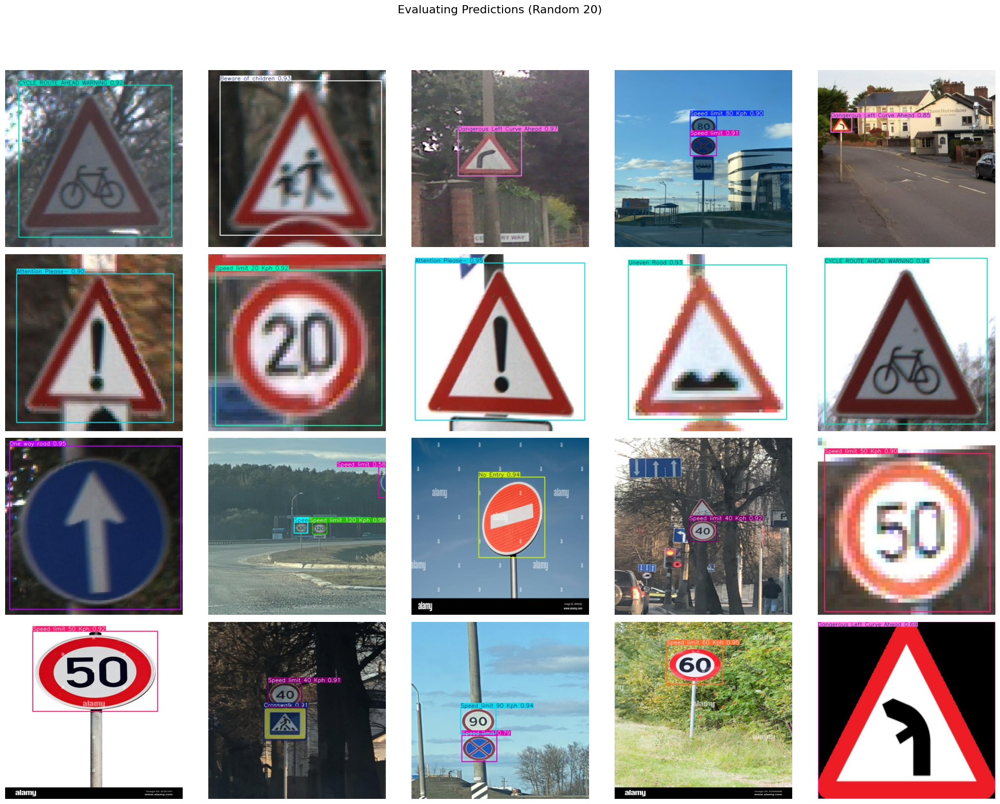

In [35]:
predict_folder = '/kaggle/working/runs/detect/predict3'

plot_predictions(predict_folder)

<font color='blue'> Calculating Metrics for the Predict mode

In [36]:
gt_dir = "/kaggle/input/roadsign-yolo/Archive/test/labels"
pred_dir = "/kaggle/working/runs/detect/predict3/labels"
calc_metrics(gt_dir, pred_dir)


Detection Metrics:
Total GT boxes: 797
Total Predicted boxes: 839
True Positives: 783
False Positives: 56
False Negatives: 14
Average IoU: 0.8759
Average Confidence: 0.8604
Class Accuracy: 0.9579
Precision: 0.9333
Recall: 0.9824
F1 Score: 0.9572


## <font color='blue'> Model Comparisons

<font color='blue'> Plotting all the result metrics from all three train runs

/kaggle/working/runs/detect/train/results.csv
/kaggle/working/runs/detect/train2/results.csv
/kaggle/working/runs/detect/train3/results.csv


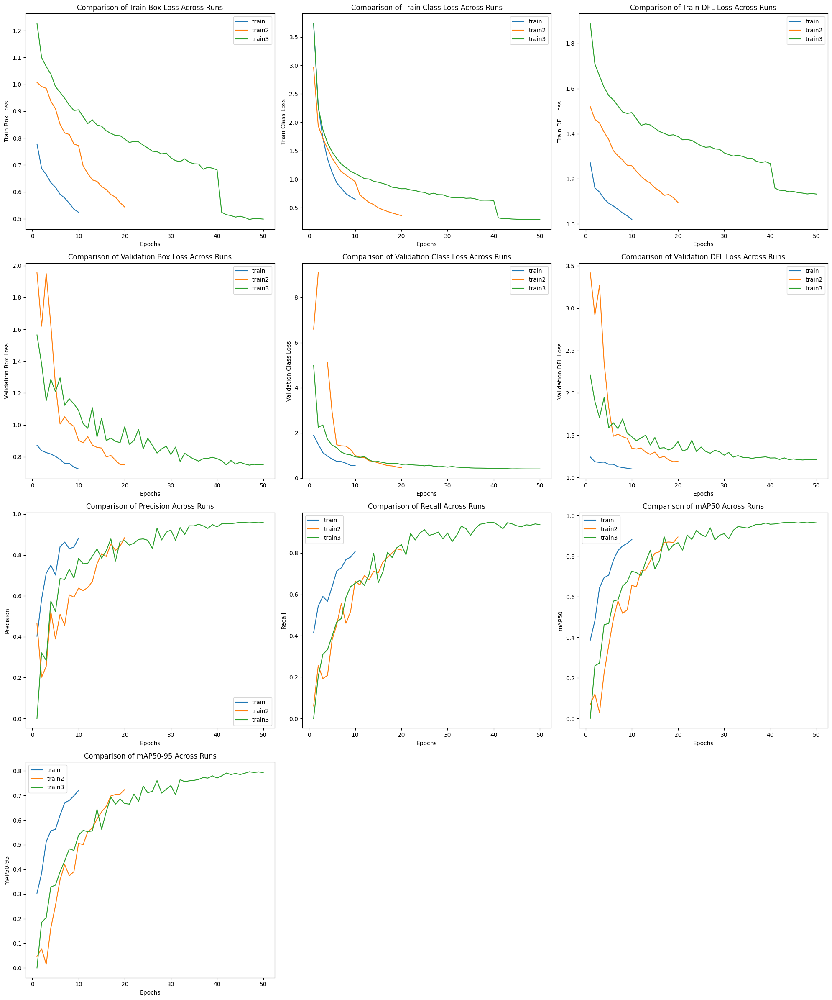

In [42]:
output_path = "/kaggle/working/runs/detect"
runs = ["train", "train2", "train3"]
data = {}

for run in runs:
    csv_path = os.path.join(output_path, run, "results.csv")
    print(csv_path)
    if os.path.exists(csv_path):
        data[run] = pd.read_csv(csv_path)
    else:
        print(f"Warning: {csv_path} not found for {run}")
        
metrics_to_plot = {
    "train/box_loss": "Train Box Loss",
    "train/cls_loss": "Train Class Loss",
    "train/dfl_loss": "Train DFL Loss",
    "val/box_loss": "Validation Box Loss",
    "val/cls_loss": "Validation Class Loss",
    "val/dfl_loss": "Validation DFL Loss",
    "metrics/precision(B)": "Precision",
    "metrics/recall(B)": "Recall",
    "metrics/mAP50(B)": "mAP50",
    "metrics/mAP50-95(B)": "mAP50-95",
}

num_metrics = len(metrics_to_plot)
num_cols = 3
num_rows = (num_metrics + num_cols - 1) // num_cols

fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 6*num_rows))

for i, (metric, metric_label) in enumerate(metrics_to_plot.items()):
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col]
    for run in runs:
        if run in data and metric in data[run].columns:
            epochs = data[run]['epoch']
            ax.plot(epochs, data[run][metric], label=f"{run}")
    ax.set_xlabel("Epochs")
    ax.set_ylabel(metric_label)
    ax.set_title(f"Comparison of {metric_label} Across Runs")
    ax.legend()

for i in range(num_metrics, num_rows * num_cols):
    row = i // num_cols
    col = i % num_cols
    axs[row, col].axis('off')

plt.tight_layout()
plt.show()

<font color='blue'> Calculate Metrics for all Prediction Runs

In [43]:
gt_dir = "/kaggle/input/roadsign-yolo/Archive/test/labels"
pred_dirs = ["/kaggle/working/runs/detect/predict/labels",
             "/kaggle/working/runs/detect/predict2/labels",
             "/kaggle/working/runs/detect/predict3/labels"]

results = {
    "run1": calculate_metrics(gt_dir, pred_dirs[0], img_width=832, img_height=832),
    "run2": calculate_metrics(gt_dir, pred_dirs[1], img_width=832, img_height=832),
    "run3": calculate_metrics(gt_dir, pred_dirs[2], img_width=832, img_height=832)
}

<font color='blue'> Plotting metrics from all three predict runs

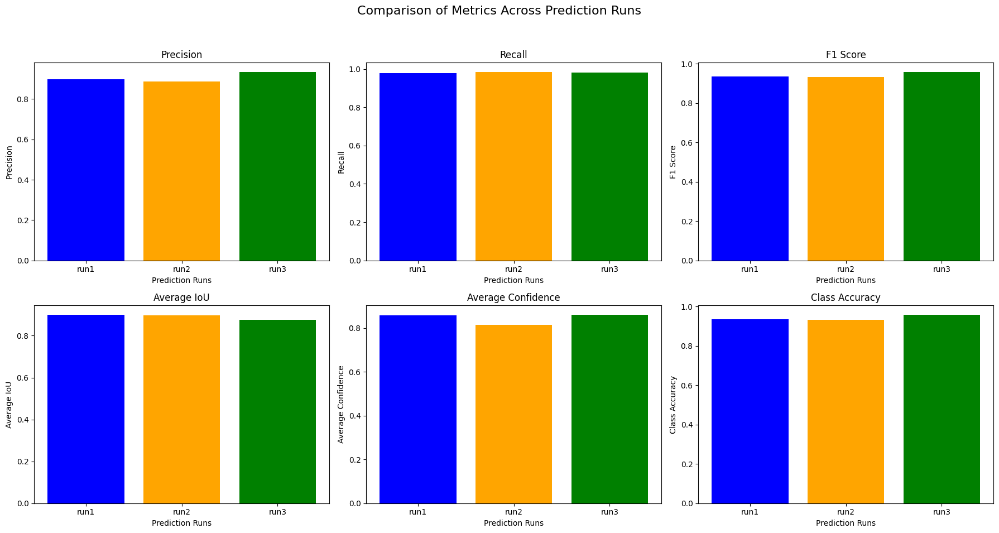

In [46]:
metrics_to_plot = ["precision", "recall", "f1_score", "average_iou", "average_confidence", "class_accuracy"]
titles = ["Precision", "Recall", "F1 Score", "Average IoU", "Average Confidence", "Class Accuracy"]

fig, axs = plt.subplots(2, 3, figsize=(18, 10)) 
fig.suptitle("Comparison of Metrics Across Prediction Runs", fontsize=16)

for i, (metric, title) in enumerate(zip(metrics_to_plot, titles)):
    row, col = divmod(i, 3)
    values = [results[run][metric] for run in results.keys()]
    
    axs[row, col].bar(results.keys(), values, color=['blue', 'orange', 'green'])
    axs[row, col].set_title(title)
    axs[row, col].set_xlabel("Prediction Runs")
    axs[row, col].set_ylabel(title)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

<font color='blue'> <b>Metric Comparison across 3 Training runs \
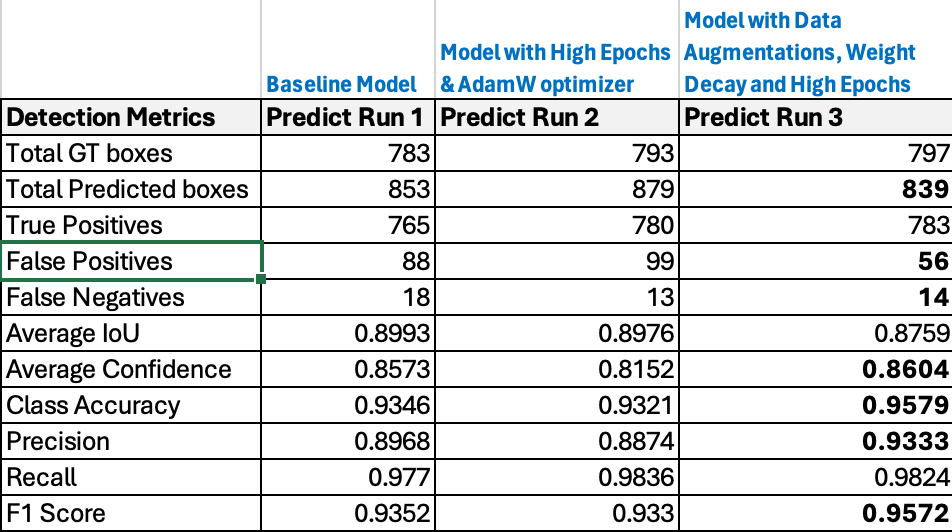
    
<font color='blue'> In Run 3, where additional hyperparameter tuning was applied, the model achieved the highest values in Precision, F1 Score, and Class Accuracy, indicating a strong improvement in overall accuracy and detection quality. While Average IoU is slightly lower in Run 3 compared to the other runs, the metrics for Precision and Average Confidence suggest that the model became more selective and reliable in its detections, with fewer false positives. This configuration provided the best balance, as shown by the high Recall and F1 Score, showing the positive impact of fine-tuned hyperparameters on achieving optimized performance in road sign detection. Due to these reasons, Run 3 is the most effective and have the best configuration for our dataset.

In [62]:
with open('/kaggle/input/roadsign-yolo/data.yaml') as f:
    data = yaml.safe_load(f)
class_names = data['names']

In [63]:
print(class_names)

['-Road narrows on right', 'Attention Please-', 'Beware of children', 'CYCLE ROUTE AHEAD WARNING', 'Crosswalk', 'Dangerous Left Curve Ahead', 'Dangerous Rright Curve Ahead', 'No Entry', 'No_Over_Taking', 'One way road', 'Speed bump ahead', 'Speed limit', 'Speed limit 100 Kph', 'Speed limit 120 Kph', 'Speed limit 20 Kph', 'Speed limit 30 Kph', 'Speed limit 40 Kph', 'Speed limit 50 Kph', 'Speed limit 60 Kph', 'Speed limit 70 Kph', 'Speed limit 80 Kph', 'Speed limit 90 Kph', 'Stop_Sign', 'Uneven Road', 'roundabout']


<font color='blue'> Generate the output CSV File

In [64]:
pred_dir = "/kaggle/working/runs/detect/predict3/labels"
image_dir = "/kaggle/input/roadsign-yolo/Archive/test/images"

image_predictions = {}
image_files = [f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.png', '.jpeg'))]

for image_file in image_files:
    image_predictions[image_file] = (None, -1)

for image_file in image_files:
    pred_label_files = [f for f in os.listdir(pred_dir) if f.endswith('.txt') and image_file.split('.')[0] in f]
    
    for pred_file in pred_label_files:
        pred_label_path = os.path.join(pred_dir, pred_file)
        with open(pred_label_path, 'r') as pred_file:
            for line in pred_file:
                values = line.strip().split()
                if len(values) < 6:
                    continue
                    
                class_id = int(values[0])
                confidence = float(values[5])

                current_confidence = image_predictions[image_file][1]
                if confidence > current_confidence:
                    class_label = class_names[class_id]
                    image_predictions[image_file] = (class_label, confidence)

rows = [
    {
        'filename': image_name,
        'class': pred[0] if pred[0] is not None else ''
    }
    for image_name, pred in image_predictions.items()
]

df = pd.DataFrame(rows)

csv_output_path = "/kaggle/working/road_sign_detection_results-original.csv"
df.to_csv(csv_output_path, index=False)

print(f"CSV saved to {csv_output_path}")
print("\nSample of the output DataFrame:")
print(df.head())
print(f"\nTotal images: {len(df)}")
print(f"Images with predictions: {len(df[df['class'] != ''])}")
print(f"Images without predictions: {len(df[df['class'] == ''])}")

CSV saved to /kaggle/working/road_sign_detection_results-original.csv

Sample of the output DataFrame:
                                            filename  \
0  00018_00007_00023_png_jpg.rf.df12c0db206c4b0ca...   
1  30_mile_speed_limit_-_geograph-org-uk_-_512715...   
2  road837_png.rf.1de96b650de409ddd234aefb8d833a5...   
3  road686_png.rf.b1dd70ec5af59b36b4c7414309059c0...   
4  Left_bend_sign_and_speed_bumps_on_Pillmawr_Roa...   

                        class  
0           Attention Please-  
1          Speed limit 30 Kph  
2          Speed limit 80 Kph  
3          Speed limit 40 Kph  
4  Dangerous Left Curve Ahead  

Total images: 623
Images with predictions: 619
Images without predictions: 4


<font color='blue'> Zip and download the working directory with all the run directories

In [52]:
!zip -r initial_training.zip /kaggle/working

  adding: kaggle/working/ (stored 0%)
  adding: kaggle/working/yolo11n.pt (deflated 11%)
  adding: kaggle/working/road_sign_detection_results.csv (deflated 61%)
  adding: kaggle/working/yolov8n.pt (deflated 9%)
  adding: kaggle/working/.virtual_documents/ (stored 0%)
  adding: kaggle/working/road_sign_detection_results-1.csv (deflated 61%)
  adding: kaggle/working/runs/ (stored 0%)
  adding: kaggle/working/runs/detect/ (stored 0%)
  adding: kaggle/working/runs/detect/val3/ (stored 0%)
  adding: kaggle/working/runs/detect/val3/val_batch2_pred.jpg (deflated 11%)
  adding: kaggle/working/runs/detect/val3/confusion_matrix_normalized.png (deflated 14%)
  adding: kaggle/working/runs/detect/val3/val_batch1_pred.jpg (deflated 6%)
  adding: kaggle/working/runs/detect/val3/val_batch2_labels.jpg (deflated 11%)
  adding: kaggle/working/runs/detect/val3/confusion_matrix.png (deflated 17%)
  adding: kaggle/working/runs/detect/val3/R_curve.png (deflated 12%)
  adding: kaggle/working/runs/detect/val3/

## <font color='purple'> Additional Experimentation
### <font color='blue'> Fine Tuning the model on Kaggle Competetion Dataset

<font color='blue'> Training the model using the best weights from the previous run and training again with 20 epochs on the Kaggle Competetion Dataset. Modified few parameters to try and improve performance

In [56]:
!yolo task=detect mode=train \
    model=/kaggle/working/runs/detect/train3/weights/best.pt \
    data="/kaggle/input/roadsign-comp/Road_Sign_Detection  3/data.yaml" \
    optimizer='AdamW' \
    epochs=20 \
    imgsz=832 \
    batch=64 \
    lr0=0.0001 \
    lrf=0.00001 \
    cos_lr=True \
    mosaic=0.3 \
    mixup=0.1 \
    weight_decay=0.001 \
    warmup_epochs=1 \
    label_smoothing=0.05 \
    dropout=0.1 \
    patience=15 \
    workers=8 \
    hsv_h=0.015 \
    hsv_s=0.3 \
    hsv_v=0.3 \
    degrees=10.0 \
    translate=0.2 \
    scale=0.3 \
    shear=0.2 \
    plots=True \
    perspective=0.0005 \
    iou=0.6 \
    conf=0.5 \
    verbose=False \
    exist_ok=False

Ultralytics 8.3.23 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=detect, mode=train, model=/kaggle/working/runs/detect/train3/weights/best.pt, data=/kaggle/input/roadsign-comp/Road_Sign_Detection  3/data.yaml, epochs=20, time=None, patience=15, batch=64, imgsz=832, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train5, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=False, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.1, val=True, split=val, save_json=False, save_hybrid=False, conf=0.5, iou=0.6, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False

<font color='blue'> Plotting the results from train run

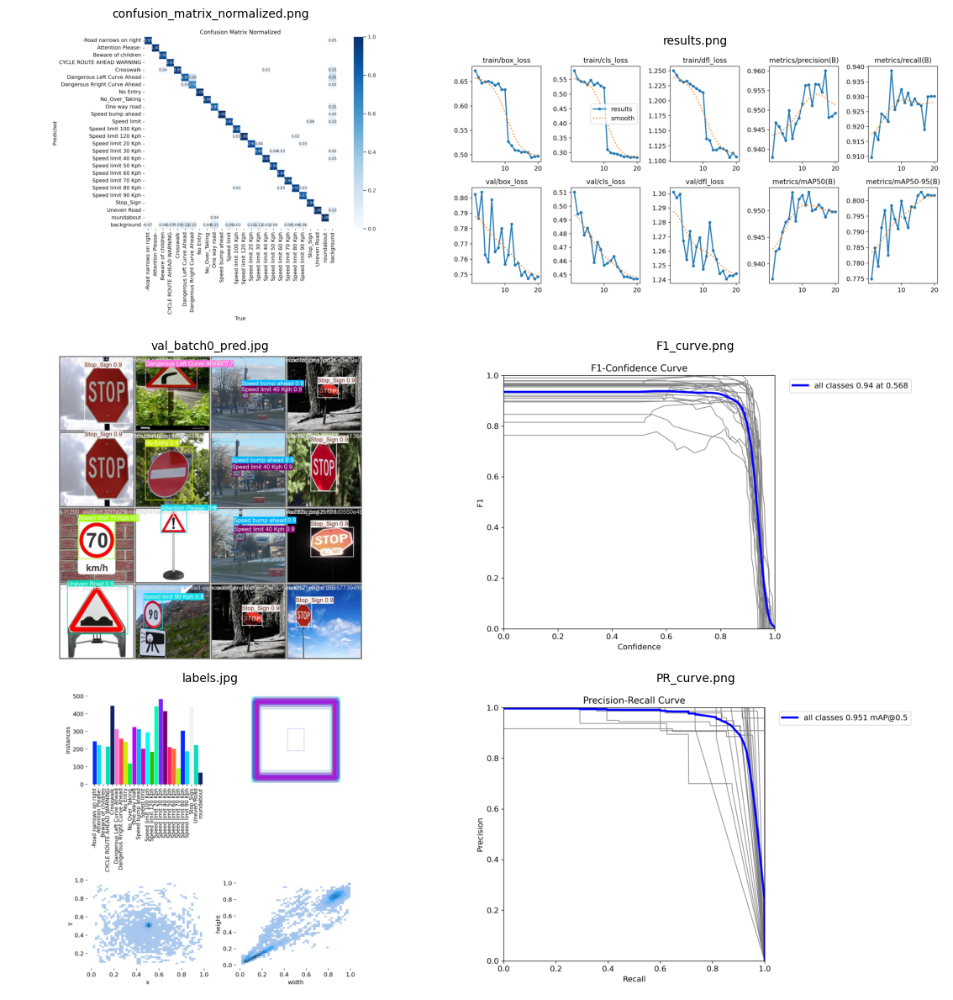

In [60]:
image_paths = [
    '/kaggle/working/runs/detect/train5/confusion_matrix_normalized.png',
    '/kaggle/working/runs/detect/train5/results.png',
    '/kaggle/working/runs/detect/train5/val_batch0_pred.jpg',
    '/kaggle/working/runs/detect/train5/F1_curve.png',
    '/kaggle/working/runs/detect/train5/labels.jpg',
    '/kaggle/working/runs/detect/train5/PR_curve.png'
]

plot_results(image_paths)

<font color='blue'> Performing Predict on Val Dataset as Train dataset does not have ground truth labels for Metrics evaluation

In [57]:
!yolo task=detect mode=predict \
model=/kaggle/working/runs/detect/train5/weights/best.pt \
conf=0.25 \
source="/kaggle/input/roadsign-comp/Road_Sign_Detection  3/valid/images" \
save=True \
save_txt=True \
save_conf=True \
verbose=False

Ultralytics 8.3.23 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 168 layers, 3,010,523 parameters, 0 gradients, 8.1 GFLOPs
Results saved to runs/detect/predict4
620 labels saved to runs/detect/predict4/labels
💡 Learn more at https://docs.ultralytics.com/modes/predict


<font color='blue'> Plotting results from Predict run on Val dataset

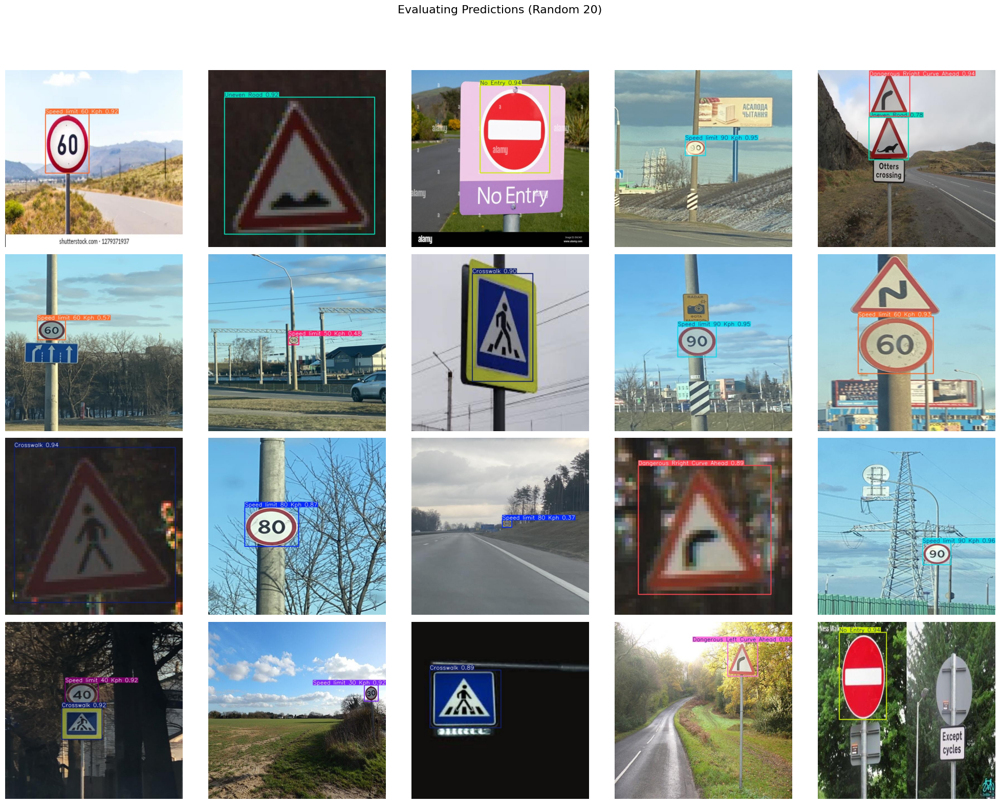

In [58]:
predict_folder = '/kaggle/working/runs/detect/predict4'

plot_predictions(predict_folder)

<font color='blue'> Calculating Metrics for the predict run on Val Dataset

In [59]:
gt_dir = "/kaggle/input/roadsign-comp/Road_Sign_Detection  3/valid/labels"
pred_dir = "/kaggle/working/runs/detect/predict4/labels"
calc_metrics(gt_dir, pred_dir)


Detection Metrics:
Total GT boxes: 798
Total Predicted boxes: 838
True Positives: 784
False Positives: 54
False Negatives: 14
Average IoU: 0.8753
Average Confidence: 0.8649
Class Accuracy: 0.9605
Precision: 0.9356
Recall: 0.9825
F1 Score: 0.9584


<font color='blue'> Class Accuracy and Confidence seems to increase after fine tuning on unseen data with same parameters as before

In [61]:
!yolo task=detect mode=predict \
model=/kaggle/working/runs/detect/train5/weights/best.pt \
conf=0.25 \
source="/kaggle/input/roadsign-comp/Road_Sign_Detection  3/test" \
save=True \
save_txt=True \
save_conf=True \
verbose=False

Ultralytics 8.3.23 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 168 layers, 3,010,523 parameters, 0 gradients, 8.1 GFLOPs
Results saved to runs/detect/predict5
297 labels saved to runs/detect/predict5/labels
💡 Learn more at https://docs.ultralytics.com/modes/predict


In [65]:
with open('/kaggle/input/roadsign-comp/Road_Sign_Detection  3/data.yaml') as f:
    data = yaml.safe_load(f)
class_names = data['names']
print(class_names)

['-Road narrows on right', 'Attention Please-', 'Beware of children', 'CYCLE ROUTE AHEAD WARNING', 'Crosswalk', 'Dangerous Left Curve Ahead', 'Dangerous Rright Curve Ahead', 'No Entry', 'No_Over_Taking', 'One way road', 'Speed bump ahead', 'Speed limit', 'Speed limit 100 Kph', 'Speed limit 120 Kph', 'Speed limit 20 Kph', 'Speed limit 30 Kph', 'Speed limit 40 Kph', 'Speed limit 50 Kph', 'Speed limit 60 Kph', 'Speed limit 70 Kph', 'Speed limit 80 Kph', 'Speed limit 90 Kph', 'Stop_Sign', 'Uneven Road', 'roundabout']


<font color='blue'> Generating CSV File considering highest confidence

In [66]:
pred_dir = "/kaggle/working/runs/detect/predict5/labels"
image_dir = "/kaggle/input/roadsign-comp/Road_Sign_Detection  3/test"

image_predictions = {}

image_files = [f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.png', '.jpeg'))]

for image_file in image_files:
    image_predictions[image_file] = (None, -1)

for image_file in image_files:
    pred_label_files = [f for f in os.listdir(pred_dir) if f.endswith('.txt') and image_file.split('.')[0] in f]
    
    for pred_file in pred_label_files:
        pred_label_path = os.path.join(pred_dir, pred_file)
        with open(pred_label_path, 'r') as pred_file:
            for line in pred_file:
                values = line.strip().split()
                if len(values) < 6:
                    continue
                    
                class_id = int(values[0])
                confidence = float(values[5])
                
                current_confidence = image_predictions[image_file][1]
                if confidence > current_confidence:
                    class_label = class_names[class_id]
                    image_predictions[image_file] = (class_label, confidence)

rows = [
    {
        'filename': image_name,
        'class': pred[0] if pred[0] is not None else '' 
    }
    for image_name, pred in image_predictions.items()
]

df = pd.DataFrame(rows)

csv_output_path = "/kaggle/working/road_sign_detection_results-comp.csv"
df.to_csv(csv_output_path, index=False)

print(f"CSV saved to {csv_output_path}")

print("\nSample of the output DataFrame:")
print(df.head())
print(f"\nTotal images: {len(df)}")
print(f"Images with predictions: {len(df[df['class'] != ''])}")
print(f"Images without predictions: {len(df[df['class'] == ''])}")

CSV saved to /kaggle/working/road_sign_detection_results-comp.csv

Sample of the output DataFrame:
                                            filename                class
0  00001_00017_00026_png_jpg.rf.5a0047279f9f590ae...   Speed limit 30 Kph
1  00001_00037_00007_png_jpg.rf.3b16db90ce7ee5551...   Speed limit 30 Kph
2  00001_00034_00017_png_jpg.rf.39418cf95e8754d21...   Speed limit 30 Kph
3  road351_png.rf.b573a808371ff05c5097774b90a3bea...   Speed limit 40 Kph
4  road718_png.rf.d12729d1856c1e49278b79c29c8f3c0...  Speed limit 100 Kph

Total images: 308
Images with predictions: 297
Images without predictions: 11


<font color='blue'> Zipping the download folder

In [67]:
!zip -qr tuned_training.zip /kaggle/working

<font color='blue'> Generating CSV file with Comma separated labels 

In [70]:
!yolo task=detect mode=predict \
model=/kaggle/working/runs/detect/train3/weights/best.pt \
conf=0.25 \
source="/kaggle/input/roadsign-comp/Road_Sign_Detection  3/test" \
save=True \
save_txt=True \
save_conf=True \
verbose=False

Ultralytics 8.3.23 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 168 layers, 3,010,523 parameters, 0 gradients, 8.1 GFLOPs
Results saved to runs/detect/predict6
299 labels saved to runs/detect/predict6/labels
💡 Learn more at https://docs.ultralytics.com/modes/predict


In [71]:
pred_dir = "/kaggle/working/runs/detect/predict6/labels"
image_dir = "/kaggle/input/roadsign-comp/Road_Sign_Detection  3/test"

image_predictions = {}

image_files = [f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.png', '.jpeg'))]

for image_file in image_files:
    image_predictions[image_file] = []

for image_file in image_files:
    pred_label_files = [f for f in os.listdir(pred_dir) if f.endswith('.txt') and image_file.split('.')[0] in f]
    
    for pred_file in pred_label_files:
        pred_label_path = os.path.join(pred_dir, pred_file)
        with open(pred_label_path, 'r') as f:
            for line in f:
                values = line.strip().split()
                if len(values) < 6:
                    continue
                    
                class_id = int(values[0])
                class_label = class_names[class_id]
                image_predictions[image_file].append(class_label)

rows = [
    {
        'filename': image_name,
        'class': ', '.join(set(preds)) if preds else '' 
    }
    for image_name, preds in image_predictions.items()
]

df = pd.DataFrame(rows)

csv_output_path = "/kaggle/working/road_sign_detection_results-comp-model3.csv"
df.to_csv(csv_output_path, index=False)

print(f"CSV saved to {csv_output_path}")

print("\nSample of the output DataFrame:")
print(df.head())
print(f"\nTotal images: {len(df)}")
print(f"Images with predictions: {len(df[df['class'] != ''])}")
print(f"Images without predictions: {len(df[df['class'] == ''])}")

CSV saved to /kaggle/working/road_sign_detection_results-comp-model3.csv

Sample of the output DataFrame:
                                            filename  \
0  00001_00017_00026_png_jpg.rf.5a0047279f9f590ae...   
1  00001_00037_00007_png_jpg.rf.3b16db90ce7ee5551...   
2  00001_00034_00017_png_jpg.rf.39418cf95e8754d21...   
3  road351_png.rf.b573a808371ff05c5097774b90a3bea...   
4  road718_png.rf.d12729d1856c1e49278b79c29c8f3c0...   

                                               class  
0                                 Speed limit 30 Kph  
1                                 Speed limit 30 Kph  
2                                 Speed limit 30 Kph  
3                   Speed limit 40 Kph, One way road  
4  Speed limit 120 Kph, Speed limit, Speed limit ...  

Total images: 308
Images with predictions: 299
Images without predictions: 9


## <font color='blue'> Thank You